# 1. Pre-requisites
## 1.1 Import packages

In [144]:
import scanpy as sc
import pandas as pd
import cellxgene_census
import anndata as ad
import tiledbsoma as soma
from tiledbsoma.experiment_query import X_as_series
import numpy as np

## 1.2 Read in data

In [96]:
#read in Tabula Sapiens Atlas for all cells
tabula = sc.read_h5ad('tabula_sapiens_all_cells.h5ad')

tabula

AnnData object with n_obs × n_vars = 483152 × 58604
    obs: 'tissue_in_publication', 'assay_ontology_term_id', 'donor_id', 'anatomical_information', 'n_counts_UMIs', 'n_genes', 'cell_ontology_class', 'free_annotation', 'manually_annotated', 'compartment', 'sex_ontology_term_id', 'disease_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'suspension_type', 'cell_type_ontology_term_id', 'tissue_ontology_term_id', 'development_stage_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage'
    var: 'feature_type', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype'
    uns: '_scvi', '_training_mode', 'dendrogram_cell_type_tissue', 'dendrogram_computational_compartment_assignment', 'dendrogram_consensus_prediction', 'dendrogram_tissue_cell_type', 'donor_id_c

# 2. Querying data 
## 2.1 Structure of data

In [4]:
#look at metadata observations
tabula.obs

,tissue_in_publication,assay_ontology_term_id,donor_id,anatomical_information,n_counts_UMIs,n_genes,cell_ontology_class,free_annotation,manually_annotated,compartment,...,development_stage_ontology_term_id,self_reported_ethnicity_ontology_term_id,cell_type,assay,disease,organism,sex,tissue,self_reported_ethnicity,development_stage
AAACCCACACTCCTGT_TSP6_Liver_NA_10X_1_1,Liver,EFO:0009922,TSP6,nan,7633.0,2259,macrophage,Monocyte/Macrophage,True,immune,...,HsapDv:0000161,HANCESTRO:0005,macrophage,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAACGAAGTACCAGAG_TSP6_Liver_NA_10X_1_1,Liver,EFO:0009922,TSP6,nan,2858.0,1152,monocyte,Monocyte,True,immune,...,HsapDv:0000161,HANCESTRO:0005,monocyte,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAACGCTCAACGGCTC_TSP6_Liver_NA_10X_1_1,Liver,EFO:0009922,TSP6,nan,7787.0,2983,endothelial cell of hepatic sinusoid,Endothelial,True,endothelial,...,HsapDv:0000161,HANCESTRO:0005,endothelial cell of hepatic sinusoid,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAAGAACAGCCTCTTC_TSP6_Liver_NA_10X_1_1,Liver,EFO:0009922,TSP6,nan,10395.0,2598,macrophage,Monocyte/Macrophage,True,immune,...,HsapDv:0000161,HANCESTRO:0005,macrophage,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAAGAACGTAGCACAG_TSP6_Liver_NA_10X_1_1,Liver,EFO:0009922,TSP6,nan,6610.0,2125,liver dendritic cell,Dendritic cell,True,immune,...,HsapDv:0000161,HANCESTRO:0005,liver dendritic cell,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P4_S364,Vasculature,EFO:0008931,TSP2,aorta,13205.0,579,endothelial cell,endothelial cell,True,endothelial,...,HsapDv:0000155,HANCESTRO:0016,endothelial cell,Smart-seq2,normal,Homo sapiens,female,aorta,African American or Afro-Caribbean,61-year-old human stage
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P5_S365,Vasculature,EFO:0008931,TSP2,aorta,9565.0,529,endothelial cell,endothelial cell,True,endothelial,...,HsapDv:0000155,HANCESTRO:0016,endothelial cell,Smart-seq2,normal,Homo sapiens,female,aorta,African American or Afro-Caribbean,61-year-old human stage
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P7_S367,Vasculature,EFO:0008931,TSP2,aorta,195639.0,2753,endothelial cell,endothelial cell,True,endothelial,...,HsapDv:0000155,HANCESTRO:0016,endothelial cell,Smart-seq2,normal,Homo sapiens,female,aorta,African American or Afro-Caribbean,61-year-old human stage
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P8_S368,Vasculature,EFO:0008931,TSP2,aorta,37260.0,984,endothelial cell,endothelial cell,True,endothelial,...,HsapDv:0000155,HANCESTRO:0016,endothelial cell,Smart-seq2,normal,Homo sapiens,female,aorta,African American or Afro-Caribbean,61-year-old human stage


This shows the metadata for the cells and confirms the presence of 483,152 cells. We want to capture the `cell_type` from this metadata.

In [15]:
tabula.obs['cell_type']

AAACCCACACTCCTGT_TSP6_Liver_NA_10X_1_1                                                      macrophage
AAACGAAGTACCAGAG_TSP6_Liver_NA_10X_1_1                                                        monocyte
AAACGCTCAACGGCTC_TSP6_Liver_NA_10X_1_1                            endothelial cell of hepatic sinusoid
AAAGAACAGCCTCTTC_TSP6_Liver_NA_10X_1_1                                                      macrophage
AAAGAACGTAGCACAG_TSP6_Liver_NA_10X_1_1                                            liver dendritic cell
                                                                                  ...                 
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P4_S364                        endothelial cell
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P5_S365                        endothelial cell
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P7_S367                        endothelial cell
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P8_S368           

There are 160 different cell types identified so may be best to start with tissue data.

In [16]:
tabula.obs['tissue']

AAACCCACACTCCTGT_TSP6_Liver_NA_10X_1_1                            liver
AAACGAAGTACCAGAG_TSP6_Liver_NA_10X_1_1                            liver
AAACGCTCAACGGCTC_TSP6_Liver_NA_10X_1_1                            liver
AAAGAACAGCCTCTTC_TSP6_Liver_NA_10X_1_1                            liver
AAAGAACGTAGCACAG_TSP6_Liver_NA_10X_1_1                            liver
                                                                  ...  
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P4_S364    aorta
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P5_S365    aorta
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P7_S367    aorta
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P8_S368    aorta
TSP2_Vasculature_aorta_SS2_B114577_B133059_Endothelial_P9_S369    aorta
Name: tissue, Length: 483152, dtype: category
Categories (45, object): ['endocrine pancreas', 'exocrine pancreas', 'lymph node', 'large intestine', ..., 'muscle of pelvic diaphragm', 'anterior part of tongue'

There are 45 identified tissue types so will start with these instead.

In [7]:
#look at data entries for genes
tabula.var

,feature_type,highly_variable,means,dispersions,dispersions_norm,mean,std,feature_is_filtered,feature_name,feature_reference,feature_biotype
ensemblid,,,,,,,,,,,
ENSG00000223972,Gene Expression,False,6.398244e-05,0.835044,-0.573947,0.000039,0.005574,False,DDX11L1,NCBITaxon:9606,gene
ENSG00000227232,Gene Expression,False,2.274395e-03,2.442280,0.533203,0.001080,0.031731,False,WASH7P,NCBITaxon:9606,gene
ENSG00000278267,Gene Expression,False,6.175251e-05,1.295335,-0.256874,0.000033,0.005634,False,MIR6859-1,NCBITaxon:9606,gene
ENSG00000243485,Gene Expression,False,1.372886e-04,2.656352,0.680668,0.000048,0.008041,False,MIR1302-2HG,NCBITaxon:9606,gene
ENSG00000284332,Gene Expression,False,1.000000e-12,NaN,0.000000,0.000000,1.000000,False,MIR1302-2,NCBITaxon:9606,gene
...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000198695,Gene Expression,False,9.634841e-01,2.466404,0.154140,0.590065,0.741395,False,MT-ND6,NCBITaxon:9606,gene
ENSG00000210194,Gene Expression,False,1.600667e-01,1.603787,-0.044396,0.083929,0.301820,False,MT-TE,NCBITaxon:9606,gene
ENSG00000198727,Gene Expression,False,4.367693e+00,4.765751,-0.499747,3.874830,1.104192,False,MT-CYB,NCBITaxon:9606,gene


This table shows each individual gene measured in the human cells (58,604 genes) and its mean expression???? across the cells. We want the `ensemblid` for these genes to identify them but the actual gene name is `feature_name`.

In [23]:
#look at count data for each gene in each cell
tabula.raw.X

<483152x58604 sparse matrix of type '<class 'numpy.float32'>'
	with 1270410953 stored elements in Compressed Sparse Row format>

This is a sparse matrix containing the log1p normalised decontX corrected counts. `tabula.X` contains the log1p normalised and scaled decontX corrected counts for each gene for each cell.

In [3]:
cellxgene = tabula.raw.X

In [4]:
#show sparse matrix coordinate system for cell x gene count data
print(cellxgene)

  (0, 38)	9.0
  (0, 137)	2.0
  (0, 148)	1.0
  (0, 197)	1.0
  (0, 229)	3.0
  (0, 256)	1.0
  (0, 266)	1.0
  (0, 273)	1.0
  (0, 297)	1.0
  (0, 332)	1.0
  (0, 350)	3.0
  (0, 364)	2.0
  (0, 366)	1.0
  (0, 386)	1.0
  (0, 416)	5.0
  (0, 420)	1.0
  (0, 423)	1.0
  (0, 477)	2.0
  (0, 492)	3.0
  (0, 518)	1.0
  (0, 541)	1.0
  (0, 581)	1.0
  (0, 612)	1.0
  (0, 623)	1.0
  (0, 625)	2.0
  :	:
  (483151, 57606)	16.0
  (483151, 57631)	0.0
  (483151, 57650)	0.0
  (483151, 57841)	0.0
  (483151, 57850)	1.0
  (483151, 57916)	1.0
  (483151, 57934)	190.0
  (483151, 57943)	1.0
  (483151, 57971)	2.0
  (483151, 58010)	1.0
  (483151, 58021)	3.0
  (483151, 58024)	5.0
  (483151, 58568)	114.0
  (483151, 58570)	6778.0
  (483151, 58572)	15.0
  (483151, 58576)	211.0
  (483151, 58582)	235.0
  (483151, 58585)	51.0
  (483151, 58588)	15.0
  (483151, 58589)	14.0
  (483151, 58593)	2.0
  (483151, 58594)	445.0
  (483151, 58598)	145.0
  (483151, 58599)	25.0
  (483151, 58601)	294.0


In [12]:
cellxgene.astype

scipy.sparse._csr.csr_matrix

## 2.2 Transform raw count data into a pandas dataframe

In [4]:
#convert sparse matrix into a pandas DataFrame
cellxgene_df = pd.DataFrame.sparse.from_spmatrix(cellxgene)

In [5]:
cellxgene_df #can't transpose as kernel keeps dying

,0,1,2,3,4,5,6,7,8,9,...,58594,58595,58596,58597,58598,58599,58600,58601,58602,58603
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,155.0,0.0,0.0,0.0,20.0,3.0,0.0,148.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,133.0,0.0,0.0,0.0,17.0,0.0,0.0,167.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,169.0,0.0,0.0,0.0,43.0,1.0,0.0,150.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,163.0,0.0,0.0,0.0,23.0,0.0,0.0,174.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,209.0,0.0,0.0,0.0,32.0,0.0,0.0,174.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,68.0,0.0,0.0,0.0,27.0,1.0,0.0,13.0,0.0,0.0
483148,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,130.0,0.0,0.0,0.0,36.0,4.0,0.0,44.0,0.0,0.0
483149,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,612.0,0.0,0.0,0.0,1573.0,110.0,0.0,1561.0,0.0,267.0
483150,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,55.0,0.0,0.0,0.0,518.0,70.0,0.0,287.0,0.0,0.0


In [ ]:
#read count data in
cellxgene_df = pd.read_csv('cellxgene_df.csv')

## 2.3 Add gene names and tissue type to pandas dataframe

In [6]:
#gene names
gene_names = tabula.var['feature_name'].values.to_list()

/tmp/ipykernel_11378/1006562779.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  gene_names = tabula.var['feature_name'].values.to_list()


In [7]:
#tissue type
tissue = tabula.obs['tissue'].values.to_list()

/tmp/ipykernel_11378/233771260.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  tissue = tabula.obs['tissue'].values.to_list()


In [8]:
cellxgene_df = cellxgene_df.set_axis(gene_names, axis = 1)
cellxgene_df['tissue'] = tissue

In [9]:
cellxgene_df

,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,RP11-34P13.7,...,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP,tissue
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,20.0,3.0,0.0,148.0,0.0,0.0,liver
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,17.0,0.0,0.0,167.0,0.0,0.0,liver
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,43.0,1.0,0.0,150.0,0.0,0.0,liver
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,23.0,0.0,0.0,174.0,0.0,0.0,liver
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,32.0,0.0,0.0,174.0,0.0,0.0,liver
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,27.0,1.0,0.0,13.0,0.0,0.0,aorta
483148,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,36.0,4.0,0.0,44.0,0.0,0.0,aorta
483149,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1573.0,110.0,0.0,1561.0,0.0,267.0,aorta
483150,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,518.0,70.0,0.0,287.0,0.0,0.0,aorta


# 3. Normalised and scaled count data

In [97]:
tabula_counts = pd.DataFrame.sparse.from_spmatrix(tabula.X)

In [98]:
#add gene names
gene_names = tabula.var['feature_name'].values.to_list()

tabula_counts = tabula_counts.set_axis(gene_names, axis = 1)

/tmp/ipykernel_1665/2122468128.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  gene_names = tabula.var['feature_name'].values.to_list()


In [99]:
#add cell type
all_cell_type = tabula.obs['cell_type'].values.to_list()

tabula_counts.insert(0, 'cell_type', all_cell_type)

/tmp/ipykernel_1665/2057349549.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  all_cell_type = tabula.obs['cell_type'].values.to_list()


In [100]:
tabula_counts

,cell_type,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
0,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.514050,0.0,0.0,0.0,3.066113,1.735281,0.0,4.651200,0.0,0.000000
1,monocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.493524,0.0,0.0,0.0,3.011087,0.000000,0.0,4.890568,0.0,0.000000
2,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.611789,0.0,0.0,0.0,3.832069,1.114132,0.0,4.693941,0.0,0.000000
3,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.344065,0.0,0.0,0.0,2.975372,0.000000,0.0,4.572667,0.0,0.000000
4,liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.443695,0.0,0.0,0.0,3.143889,0.000000,0.0,4.533354,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483147,endothelial cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.455786,0.0,0.0,0.0,2.986555,0.760420,0.0,2.158757,0.0,0.000000
483148,endothelial cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.292184,0.0,0.0,0.0,3.560022,2.219024,0.0,3.486868,0.0,0.000000
483149,endothelial cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.031555,0.0,0.0,0.0,4.286012,2.549905,0.0,3.976863,0.0,5.355007
483150,endothelial cell,0.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.405994,0.0,0.0,0.0,4.814424,4.026218,0.0,3.945915,0.0,0.000000


In [ ]:
tabula_counts.groupby(['cell_type']).mean() #too long to compute

In [ ]:
tabula_counts.groupby(['cell_type']).sum() #too long to compute

# Census API

# Liver

# 1. Generate data subset
## 1.1 Search census

In [2]:
census = cellxgene_census.open_soma()

The "stable" release is currently 2023-07-25. Specify 'census_version="2023-07-25"' in future calls to open_soma() to ensure data consistency.


In [3]:
#fetch human RNA experiments
human = census["census_data"]["homo_sapiens"]
human_rna = human.ms["RNA"]

In [4]:
#fetch datasets
datasets_df = census["census_info"]["datasets"].read().concat().to_pandas()

datasets_df

,soma_joinid,collection_id,collection_name,collection_doi,dataset_id,dataset_title,dataset_h5ad_path,dataset_total_cell_count
0,0,e2c257e7-6f79-487c-b81c-39451cd4ab3c,Spatial multiomics map of trophoblast developm...,10.1038/s41586-023-05869-0,f171db61-e57e-4535-a06a-35d8b6ef8f2b,donor_p13_trophoblasts,f171db61-e57e-4535-a06a-35d8b6ef8f2b.h5ad,31497
1,1,e2c257e7-6f79-487c-b81c-39451cd4ab3c,Spatial multiomics map of trophoblast developm...,10.1038/s41586-023-05869-0,ecf2e08e-2032-4a9e-b466-b65b395f4a02,All donors trophoblasts,ecf2e08e-2032-4a9e-b466-b65b395f4a02.h5ad,67070
2,2,e2c257e7-6f79-487c-b81c-39451cd4ab3c,Spatial multiomics map of trophoblast developm...,10.1038/s41586-023-05869-0,74cff64f-9da9-4b2a-9b3b-8a04a1598040,All donors all cell states (in vivo),74cff64f-9da9-4b2a-9b3b-8a04a1598040.h5ad,286326
3,3,f7cecffa-00b4-4560-a29a-8ad626b8ee08,Mapping single-cell transcriptomes in the intr...,10.1016/j.ccell.2022.11.001,5af90777-6760-4003-9dba-8f945fec6fdf,Single-cell transcriptomic datasets of Renal c...,5af90777-6760-4003-9dba-8f945fec6fdf.h5ad,270855
4,4,3f50314f-bdc9-40c6-8e4a-b0901ebfbe4c,Single-cell sequencing links multiregional imm...,10.1016/j.ccell.2021.03.007,bd65a70f-b274-4133-b9dd-0d1431b6af34,Single-cell sequencing links multiregional imm...,bd65a70f-b274-4133-b9dd-0d1431b6af34.h5ad,167283
...,...,...,...,...,...,...,...,...
588,588,180bff9c-c8a5-4539-b13b-ddbc00d643e6,Molecular characterization of selectively vuln...,10.1038/s41593-020-00764-7,f9ad5649-f372-43e1-a3a8-423383e5a8a2,Molecular characterization of selectively vuln...,f9ad5649-f372-43e1-a3a8-423383e5a8a2.h5ad,8168
589,589,a72afd53-ab92-4511-88da-252fb0e26b9a,Single-cell atlas of peripheral immune respons...,10.1038/s41591-020-0944-y,456e8b9b-f872-488b-871d-94534090a865,Single-cell atlas of peripheral immune respons...,456e8b9b-f872-488b-871d-94534090a865.h5ad,44721
590,590,38833785-fac5-48fd-944a-0f62a4c23ed1,Construction of a human cell landscape at sing...,10.1038/s41586-020-2157-4,2adb1f8a-a6b1-4909-8ee8-484814e2d4bf,Construction of a human cell landscape at sing...,2adb1f8a-a6b1-4909-8ee8-484814e2d4bf.h5ad,598266
591,591,5d445965-6f1a-4b68-ba3a-b8f765155d3a,A molecular cell atlas of the human lung from ...,10.1038/s41586-020-2922-4,e04daea4-4412-45b5-989e-76a9be070a89,"Krasnow Lab Human Lung Cell Atlas, Smart-seq2",e04daea4-4412-45b5-989e-76a9be070a89.h5ad,9409


In [148]:
#search for Tabula Sapiens Dataset
datasets_df[datasets_df['collection_doi'] == '10.1126/science.abl4896'].sort_values(by = 'dataset_total_cell_count', 
                                                                                    ascending = True)

NameError: name 'datasets_df' is not defined

In [34]:
presence_matrix = cellxgene_census.get_presence_matrix(census, organism="Homo sapiens", measurement_name="RNA")

presence_matrix

<593x60664 sparse matrix of type '<class 'numpy.uint8'>'
	with 16133717 stored elements in Compressed Sparse Row format>

In [36]:
var_df = human_rna.var.read().concat().to_pandas()

var_df

,soma_joinid,feature_id,feature_name,feature_length
0,0,ENSG00000121410,A1BG,3999
1,1,ENSG00000268895,A1BG-AS1,3374
2,2,ENSG00000148584,A1CF,9603
3,3,ENSG00000175899,A2M,6318
4,4,ENSG00000245105,A2M-AS1,2948
...,...,...,...,...
60659,60659,ENSG00000288719,RP4-669P10.21,4252
60660,60660,ENSG00000288720,RP11-852E15.3,7007
60661,60661,ENSG00000288721,RP5-973N23.5,7765
60662,60662,ENSG00000288723,RP11-553N16.6,1015


The presence matrix is indexed by `soma_joinid`: the first dimension is the **datasets** `soma_joinid` as in the `census_datasets` and the second dimension is the **feature's** `soma_joinid` as in the `var` dataframe

## 1.2 Download data subset

Liver has the smallest number of cells (5007) within the Tabula Sapiens dataset so we'll subset these and start analysis here first.

In [29]:
cellxgene_census.download_source_h5ad(dataset_id = '6d41668c-168c-4500-b06a-4674ccf3e19d', 
                                              to_path = '/home/jupyter/tabula_sapiens_liver.h5ad')

In [2]:
liver = sc.read_h5ad('tabula_sapiens_liver.h5ad')

In [33]:
liver

AnnData object with n_obs × n_vars = 5007 × 58604
    obs: 'assay_ontology_term_id', 'donor_id', 'anatomical_information', 'n_counts_UMIs', 'n_genes', 'cell_ontology_class', 'free_annotation', 'manually_annotated', 'compartment', 'sex_ontology_term_id', 'disease_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'suspension_type', 'cell_type_ontology_term_id', 'tissue_ontology_term_id', 'development_stage_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage'
    var: 'feature_type', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'ensembl_version', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype'
    uns: '_scvi', '_training_mode', 'assay_colors', 'cell_ontology_class_colors', 'dendrogram_cell_type_tissue', 'dendrogram_computational_compartment_assignment', 'dendrogram_consensus_prediction', 'den

## 1.3 Identifying all genes measured in the liver dataset

In [37]:
#slice dataset of interest and get the joinid (unqiue dataset index in the census)
dataset_joinid = datasets_df.loc[datasets_df.dataset_id == '6d41668c-168c-4500-b06a-4674ccf3e19d'].soma_joinid

#slice presence (gene) matrix by first dimension which is dataset
var_joinids = presence_matrix[dataset_joinid, :].tocoo().col

#from the 
var_df.loc[var_df.soma_joinid.isin(var_joinids)]

,soma_joinid,feature_id,feature_name,feature_length
0,0,ENSG00000121410,A1BG,3999
1,1,ENSG00000268895,A1BG-AS1,3374
2,2,ENSG00000148584,A1CF,9603
3,3,ENSG00000175899,A2M,6318
4,4,ENSG00000245105,A2M-AS1,2948
...,...,...,...,...
58621,58621,ENSG00000210184,MT-TS2,59
58622,58622,ENSG00000210191,MT-TL2,71
58623,58623,ENSG00000210194,MT-TE,69
58624,58624,ENSG00000210195,MT-TT,66


# 2. Querying Data
## 2.1 Liver Metadata

In [42]:
liver.obs

,assay_ontology_term_id,donor_id,anatomical_information,n_counts_UMIs,n_genes,cell_ontology_class,free_annotation,manually_annotated,compartment,sex_ontology_term_id,...,development_stage_ontology_term_id,self_reported_ethnicity_ontology_term_id,cell_type,assay,disease,organism,sex,tissue,self_reported_ethnicity,development_stage
cell_id,,,,,,,,,,,,,,,,,,,,,
AAACCCACACTCCTGT_TSP6_Liver_NA_10X_1_1,EFO:0009922,TSP6,nan,7633.0,2259,macrophage,Monocyte/Macrophage,True,immune,PATO:0000384,...,HsapDv:0000161,HANCESTRO:0005,macrophage,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAACGAAGTACCAGAG_TSP6_Liver_NA_10X_1_1,EFO:0009922,TSP6,nan,2858.0,1152,monocyte,Monocyte,True,immune,PATO:0000384,...,HsapDv:0000161,HANCESTRO:0005,monocyte,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAACGCTCAACGGCTC_TSP6_Liver_NA_10X_1_1,EFO:0009922,TSP6,nan,7787.0,2983,endothelial cell of hepatic sinusoid,Endothelial,True,endothelial,PATO:0000384,...,HsapDv:0000161,HANCESTRO:0005,endothelial cell of hepatic sinusoid,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAAGAACAGCCTCTTC_TSP6_Liver_NA_10X_1_1,EFO:0009922,TSP6,nan,10395.0,2598,macrophage,Monocyte/Macrophage,True,immune,PATO:0000384,...,HsapDv:0000161,HANCESTRO:0005,macrophage,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
AAAGAACGTAGCACAG_TSP6_Liver_NA_10X_1_1,EFO:0009922,TSP6,nan,6610.0,2125,liver dendritic cell,Dendritic cell,True,immune,PATO:0000384,...,HsapDv:0000161,HANCESTRO:0005,liver dendritic cell,10x 3' v3,normal,Homo sapiens,male,liver,European,67-year-old human stage
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGATCCATCGGCCA_TSP14_Liver_NA_10X_2_1,EFO:0009922,TSP14,nan,32707.0,4815,hepatocyte,Hepatocyte,True,epithelial,PATO:0000384,...,HsapDv:0000153,HANCESTRO:0005,hepatocyte,10x 3' v3,normal,Homo sapiens,male,liver,European,59-year-old human stage
TTTGGAGTCAGTCTTT_TSP14_Liver_NA_10X_2_1,EFO:0009922,TSP14,nan,19864.0,3526,hepatocyte,Hepatocyte,True,epithelial,PATO:0000384,...,HsapDv:0000153,HANCESTRO:0005,hepatocyte,10x 3' v3,normal,Homo sapiens,male,liver,European,59-year-old human stage
TTTGGTTGTCACTCGG_TSP14_Liver_NA_10X_2_1,EFO:0009922,TSP14,nan,2550.0,1389,endothelial cell of hepatic sinusoid,Endothelial,True,endothelial,PATO:0000384,...,HsapDv:0000153,HANCESTRO:0005,endothelial cell of hepatic sinusoid,10x 3' v3,normal,Homo sapiens,male,liver,European,59-year-old human stage


## 2.2 Liver Feature Data (same as all cells feature mean counts)

In [43]:
liver.var

,feature_type,highly_variable,means,dispersions,dispersions_norm,mean,std,ensembl_version,feature_is_filtered,feature_name,feature_reference,feature_biotype
ensemblid,,,,,,,,,,,,
ENSG00000223972,Gene Expression,False,6.398244e-05,0.835044,-0.573947,0.000039,0.005574,ENSG00000223972.5,False,DDX11L1,NCBITaxon:9606,gene
ENSG00000227232,Gene Expression,False,2.274395e-03,2.442280,0.533203,0.001080,0.031731,ENSG00000227232.5,False,WASH7P,NCBITaxon:9606,gene
ENSG00000278267,Gene Expression,False,6.175251e-05,1.295335,-0.256874,0.000033,0.005634,ENSG00000278267.1,False,MIR6859-1,NCBITaxon:9606,gene
ENSG00000243485,Gene Expression,False,1.372886e-04,2.656352,0.680668,0.000048,0.008041,ENSG00000243485.5,False,MIR1302-2HG,NCBITaxon:9606,gene
ENSG00000284332,Gene Expression,False,1.000000e-12,NaN,0.000000,0.000000,1.000000,ENSG00000284332.1,False,MIR1302-2,NCBITaxon:9606,gene
...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000198695,Gene Expression,False,9.634841e-01,2.466404,0.154140,0.590065,0.741395,ENSG00000198695.2,False,MT-ND6,NCBITaxon:9606,gene
ENSG00000210194,Gene Expression,False,1.600667e-01,1.603787,-0.044396,0.083929,0.301820,ENSG00000210194.1,False,MT-TE,NCBITaxon:9606,gene
ENSG00000198727,Gene Expression,False,4.367693e+00,4.765751,-0.499747,3.874830,1.104192,ENSG00000198727.2,False,MT-CYB,NCBITaxon:9606,gene


## 2.3 Feature counts in each cell from liver

In [47]:
print(liver.raw.X) #log1p normalised decontX corrected counts

  (0, 38)	9.0
  (0, 137)	2.0
  (0, 148)	1.0
  (0, 197)	1.0
  (0, 229)	3.0
  (0, 256)	1.0
  (0, 266)	1.0
  (0, 273)	1.0
  (0, 297)	1.0
  (0, 332)	1.0
  (0, 350)	3.0
  (0, 364)	2.0
  (0, 366)	1.0
  (0, 386)	1.0
  (0, 416)	5.0
  (0, 420)	1.0
  (0, 423)	1.0
  (0, 477)	2.0
  (0, 492)	3.0
  (0, 518)	1.0
  (0, 541)	1.0
  (0, 581)	1.0
  (0, 612)	1.0
  (0, 623)	1.0
  (0, 625)	2.0
  :	:
  (5006, 57216)	1.0
  (5006, 57306)	1.0
  (5006, 57363)	1.0
  (5006, 57371)	2.0
  (5006, 57464)	2.0
  (5006, 57597)	1.0
  (5006, 57700)	1.0
  (5006, 58107)	1.0
  (5006, 58241)	1.0
  (5006, 58332)	1.0
  (5006, 58348)	1.0
  (5006, 58351)	1.0
  (5006, 58568)	8.0
  (5006, 58570)	18.0
  (5006, 58572)	4.0
  (5006, 58576)	2.0
  (5006, 58582)	12.0
  (5006, 58585)	4.0
  (5006, 58588)	7.0
  (5006, 58589)	10.0
  (5006, 58591)	5.0
  (5006, 58593)	1.0
  (5006, 58594)	7.0
  (5006, 58598)	1.0
  (5006, 58601)	2.0


In [49]:
print(liver.X) #log1p normalised and scaled decontX corrected counts

  (0, 38)	2.3135314
  (0, 137)	2.017924
  (0, 148)	1.7682451
  (0, 197)	2.9146569
  (0, 229)	1.7524959
  (0, 256)	1.6055938
  (0, 266)	1.9191335
  (0, 273)	1.1627396
  (0, 297)	0.94154125
  (0, 332)	2.2555065
  (0, 350)	2.5699217
  (0, 364)	3.0685349
  (0, 366)	1.6374199
  (0, 386)	4.1950088
  (0, 416)	3.1584241
  (0, 420)	2.244354
  (0, 423)	1.790217
  (0, 477)	2.259219
  (0, 492)	2.2818408
  (0, 518)	1.5732617
  (0, 541)	1.986201
  (0, 581)	3.7468507
  (0, 612)	2.1255298
  (0, 623)	1.2339125
  (0, 625)	2.1744208
  :	:
  (5006, 57216)	10.0
  (5006, 57306)	3.2512813
  (5006, 57363)	1.8781296
  (5006, 57371)	1.8061343
  (5006, 57464)	10.0
  (5006, 57597)	6.4817824
  (5006, 57700)	10.0
  (5006, 58107)	6.480399
  (5006, 58241)	5.1344576
  (5006, 58332)	10.0
  (5006, 58348)	4.1966047
  (5006, 58351)	6.4616237
  (5006, 58568)	2.2135978
  (5006, 58570)	3.0771492
  (5006, 58572)	0.0
  (5006, 58576)	0.0
  (5006, 58582)	0.0
  (5006, 58585)	1.4261405
  (5006, 58588)	2.0721047
  (5006, 58589)	2.1

Compared to the whole cell dataset we see that the index only goes as far as 5006 since there are only 5006 cells in this sample.

In [3]:
#convert sparse matrix into pandas dataframe
liver_counts = pd.DataFrame.sparse.from_spmatrix(liver.X)

liver_counts

,0,1,2,3,4,5,6,7,8,9,...,58594,58595,58596,58597,58598,58599,58600,58601,58602,58603
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.514050,0.000000,0.000000,0.0,3.066113,1.735281,0.000000,4.651200,0.0,0.000000
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.493524,0.000000,0.000000,0.0,3.011087,0.000000,0.000000,4.890568,0.0,0.000000
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.611789,0.000000,0.000000,0.0,3.832069,1.114132,0.000000,4.693941,0.0,0.000000
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.344065,0.000000,0.000000,0.0,2.975372,0.000000,0.000000,4.572667,0.0,0.000000
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.443695,0.000000,0.000000,0.0,3.143889,0.000000,0.000000,4.533354,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.577865,1.506503,0.792537,0.0,3.344307,1.543429,0.883882,4.122873,0.0,2.078453
5003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.099157,0.000000,1.211337,0.0,2.707354,0.939532,4.610079,3.635269,0.0,1.836136
5004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.390459,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.973971,0.0,0.000000
5005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.335147,0.000000,0.000000,0.0,1.490789,0.000000,0.000000,2.239632,0.0,0.000000


In [4]:
#add gene names
gene_names = liver.var['feature_name'].values.to_list()

liver_counts = liver_counts.set_axis(gene_names, axis = 1)

/tmp/ipykernel_2588/3747516722.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  gene_names = liver.var['feature_name'].values.to_list()


In [5]:
#add cell type
cell_type = liver.obs['cell_type'].values.to_list()

liver_counts.insert(0, 'cell_type', cell_type)

/tmp/ipykernel_2588/4228034290.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  cell_type = liver.obs['cell_type'].values.to_list()


In [6]:
liver_counts

,cell_type,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
0,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.514050,0.000000,0.000000,0.0,3.066113,1.735281,0.000000,4.651200,0.0,0.000000
1,monocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.493524,0.000000,0.000000,0.0,3.011087,0.000000,0.000000,4.890568,0.0,0.000000
2,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.611789,0.000000,0.000000,0.0,3.832069,1.114132,0.000000,4.693941,0.0,0.000000
3,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.344065,0.000000,0.000000,0.0,2.975372,0.000000,0.000000,4.572667,0.0,0.000000
4,liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.443695,0.000000,0.000000,0.0,3.143889,0.000000,0.000000,4.533354,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5002,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.577865,1.506503,0.792537,0.0,3.344307,1.543429,0.883882,4.122873,0.0,2.078453
5003,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.099157,0.000000,1.211337,0.0,2.707354,0.939532,4.610079,3.635269,0.0,1.836136
5004,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.390459,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.973971,0.0,0.000000
5005,mature NK T cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.335147,0.000000,0.000000,0.0,1.490789,0.000000,0.000000,2.239632,0.0,0.000000


## 2.4 Group cells by cell_type and calculate mean/max/min counts

In [56]:
mean_liver_celltype_counts = liver_counts.groupby(['cell_type']).mean()

mean_liver_celltype_counts

,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,RP11-34P13.7,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.032115,0.000000,...,2.512586,0.102248,0.833871,0.000000,2.104467,0.834605,0.082828,2.944506,0.000000,0.574849
endothelial cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.112360,...,3.340878,0.876239,1.751234,0.290804,2.723587,0.542309,1.736698,3.360179,0.464296,1.767306
endothelial cell of hepatic sinusoid,0.000000,0.021941,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.071259,...,3.998466,0.142199,0.292168,0.023753,3.130816,1.111958,0.252218,4.392995,0.065563,0.578845
erythrocyte,0.000000,0.092593,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,...,1.918333,0.349128,0.334532,0.277778,0.862840,0.325513,0.301887,2.094667,0.388818,0.663664
fibroblast,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,...,4.162356,0.085085,0.140405,0.000000,3.131070,1.020273,0.181169,4.604664,0.040551,0.442607
hepatocyte,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.052138,...,2.386197,0.323947,0.345409,0.006418,1.795274,0.795824,0.966829,2.905960,0.023539,0.877691
intrahepatic cholangiocyte,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,...,2.180011,0.352835,0.915551,0.000000,1.975725,0.503002,0.069126,3.276374,0.000000,0.797622
liver dendritic cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,...,4.164716,0.000000,0.000000,0.000000,2.962616,0.715297,0.000000,4.438912,0.000000,0.182671
macrophage,0.000000,0.045728,0.0,0.007241,0.0,0.0,0.0,0.0,0.000000,0.007241,...,4.467597,0.047702,0.003813,0.000000,3.286415,0.960659,0.019971,4.611423,0.041685,0.116263


In [93]:
liver_counts.groupby(['cell_type']).max()

,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,RP11-34P13.7,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,4.688824,0.0,...,4.890596,7.974380,4.758667,0.0,4.044439,3.731498,4.751534,5.143526,0.000000,3.792091
endothelial cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,10.0,...,4.071805,9.935444,6.060705,10.0,3.805734,2.453102,5.961488,4.215557,6.757763,4.869277
endothelial cell of hepatic sinusoid,0.000000,9.236962,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,10.0,...,4.996616,9.085077,6.458852,10.0,4.289569,3.327561,7.203276,5.266097,5.942534,4.381944
erythrocyte,0.000000,10.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,3.214751,6.637105,4.223972,10.0,3.867557,3.205790,4.299047,3.756658,8.257171,3.435687
fibroblast,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,4.820822,6.466425,4.698508,0.0,4.155768,3.501637,5.516358,5.255797,3.081901,4.249220
hepatocyte,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,10.0,...,5.089682,7.723903,4.492881,10.0,4.906166,4.320244,8.422518,5.169803,6.372562,5.484859
intrahepatic cholangiocyte,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,4.628842,7.825184,4.524271,0.0,3.693820,2.059793,2.903297,5.145566,0.000000,3.038121
liver dendritic cell,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,4.505734,0.000000,0.000000,0.0,4.180662,2.847399,0.000000,4.904300,0.000000,1.829336
macrophage,0.000000,10.000000,0.0,10.000000,0.0,0.0,0.0,0.0,0.000000,10.0,...,5.041943,8.015737,5.265604,0.0,5.375360,4.162887,6.786386,5.193099,7.705392,4.807437


In [95]:
liver_counts.groupby(['cell_type']).min()

,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,RP11-34P13.7,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.019300,0.0,0.0,0.0,0.000000,0.0,0.0,1.275475,0.0,0.0
endothelial cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.056292,0.0,0.0,0.0,0.000000,0.0,0.0,1.492693,0.0,0.0
endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.130099,0.0,0.0,0.0,0.000000,0.0,0.0,1.538484,0.0,0.0
erythrocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.143380,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
fibroblast,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.690986,0.0,0.0,0.0,1.212527,0.0,0.0,2.658746,0.0,0.0
hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0
intrahepatic cholangiocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.174331,0.0,0.0,0.0,1.036679,0.0,0.0,2.306379,0.0,0.0
liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.596870,0.0,0.0,0.0,2.330173,0.0,0.0,3.376415,0.0,0.0
macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.237032,0.0,0.0,0.0,1.258663,0.0,0.0,0.304779,0.0,0.0


In [122]:
liver_counts.dtypes

cell_type                  object
DDX11L1        Sparse[float32, 0]
WASH7P         Sparse[float32, 0]
MIR6859-1      Sparse[float32, 0]
MIR1302-2HG    Sparse[float32, 0]
                      ...        
MT-ND6         Sparse[float32, 0]
MT-TE          Sparse[float32, 0]
MT-CYB         Sparse[float32, 0]
MT-TT          Sparse[float32, 0]
MT-TP          Sparse[float32, 0]
Length: 58605, dtype: object

### Side-Note: Mean counts for all genes with non-zero expression in at least 1 cell

In [123]:
liver_counts.loc[:, (liver_counts != 0).any(axis = 0)].groupby(['cell_type']).mean()

,DDX11L1,WASH7P,MIR1302-2HG,OR4F5,RP11-34P13.7,RP11-34P13.8,CICP27,RP11-34P13.15,RP11-34P13.16,RP11-34P13.14,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,0.000000,0.000000,0.000000,0.032115,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.512586,0.102248,0.833871,0.000000,2.104467,0.834605,0.082828,2.944506,0.000000,0.574849
endothelial cell,0.000000,0.000000,0.000000,0.000000,0.112360,0.000000,0.000000,0.020240,0.000000,0.000000,...,3.340878,0.876239,1.751234,0.290804,2.723587,0.542309,1.736698,3.360179,0.464296,1.767306
endothelial cell of hepatic sinusoid,0.000000,0.021941,0.000000,0.000000,0.071259,0.000000,0.000000,0.057809,0.000000,0.000000,...,3.998466,0.142199,0.292168,0.023753,3.130816,1.111958,0.252218,4.392995,0.065563,0.578845
erythrocyte,0.000000,0.092593,0.000000,0.000000,0.000000,0.000000,0.070088,0.000000,0.000000,0.000000,...,1.918333,0.349128,0.334532,0.277778,0.862840,0.325513,0.301887,2.094667,0.388818,0.663664
fibroblast,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,4.162356,0.085085,0.140405,0.000000,3.131070,1.020273,0.181169,4.604664,0.040551,0.442607
hepatocyte,0.000000,0.000000,0.000000,0.000000,0.052138,0.006418,0.000000,0.020232,0.000000,0.000000,...,2.386197,0.323947,0.345409,0.006418,1.795274,0.795824,0.966829,2.905960,0.023539,0.877691
intrahepatic cholangiocyte,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.180011,0.352835,0.915551,0.000000,1.975725,0.503002,0.069126,3.276374,0.000000,0.797622
liver dendritic cell,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.238659,0.000000,0.000000,...,4.164716,0.000000,0.000000,0.000000,2.962616,0.715297,0.000000,4.438912,0.000000,0.182671
macrophage,0.000000,0.045728,0.007241,0.000000,0.007241,0.000000,0.032613,0.333385,0.029935,0.000000,...,4.467597,0.047702,0.003813,0.000000,3.286415,0.960659,0.019971,4.611423,0.041685,0.116263


## 2.5 Liver median counts grouped by cell_type

# **************************** Inelegant Method **************************************

In [15]:
def sparse_col_to_pandas(df):
    
    import pandas as pd
    
    #create new dataframe with cell types in
    new_df = pd.DataFrame(df['cell_type'])
    
    for column in df.columns[1:]:
        
        #calculate dense array from sparse array for each column
        values = df[column].values.to_dense()
        
        #add column to new_df
        new_df[column] = values
        
    return new_df

In [23]:
liver_counts_df = sparse_col_to_pandas(liver_counts)

/tmp/ipykernel_2588/2426443109.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_df[column] = values
/tmp/ipykernel_2588/2426443109.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  new_df[column] = values
/tmp/ipykernel_2588/2426443109.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  n

In [30]:
#save as compressed gzip
liver_counts_df.to_pickle('liver_counts_df.gz', compression = 'gzip')

In [25]:
liver_counts_df.dtypes

cell_type       object
DDX11L1        float32
WASH7P         float32
MIR6859-1      float32
MIR1302-2HG    float32
                ...   
MT-ND6         float32
MT-TE          float32
MT-CYB         float32
MT-TT          float32
MT-TP          float32
Length: 58605, dtype: object

## **********************************************************************************************************

In [37]:
summary_liver_counts = liver_counts_df.groupby('cell_type').describe()

summary_liver_counts

DDX11L1                                \
                                       count      mean       std  min  25%   
cell_type                                                                    
T cell                                 146.0  0.000000  0.000000  0.0  0.0   
endothelial cell                       267.0  0.000000  0.000000  0.0  0.0   
endothelial cell of hepatic sinusoid   421.0  0.000000  0.000000  0.0  0.0   
erythrocyte                            108.0  0.000000  0.000000  0.0  0.0   
fibroblast                              76.0  0.000000  0.000000  0.0  0.0   
hepatocyte                            1558.0  0.000000  0.000000  0.0  0.0   
intrahepatic cholangiocyte              42.0  0.000000  0.000000  0.0  0.0   
liver dendritic cell                    34.0  0.000000  0.000000  0.0  0.0   
macrophage                            1381.0  0.000000  0.000000  0.0  0.0   
mature NK T cell                       245.0  0.000000  0.000000  0.0  0.0   
monocyte                               612.0  0.009344  0.231154  0.0  0.0   
neutrophil                              83.0  0.000000  0.000000  0.0  0.0   
plasma cell                             34.0  0.000000  0.000000  0.0  0.0   

                                                          WASH7P            \
                                      50%  75%       max   count      mean   
cell_type                                                                    
T cell                                0.0  0.0  0.000000   146.0  0.000000   
endothelial cell                      0.0  0.0  0.000000   267.0  0.000000   
endothelial cell of hepatic sinusoid  0.0  0.0  0.000000   421.0  0.021941   
erythrocyte                           0.0  0.0  0.000000   108.0  0.092593   
fibroblast                            0.0  0.0  0.000000    76.0  0.000000   
hepatocyte                            0.0  0.0  0.000000  1558.0  0.000000   
intrahepatic cholangiocyte            0.0  0.0  0.000000    42.0  0.000000   
liver dendritic cell                  0.0  0.0  0.000000    34.0  0.000000   
macrophage                            0.0  0.0  0.000000  1381.0  0.045728   
mature NK T cell                      0.0  0.0  0.000000   245.0  0.009981   
monocyte                              0.0  0.0  5.718421   612.0  0.001771   
neutrophil                            0.0  0.0  0.000000    83.0  0.000000   
plasma cell                           0.0  0.0  0.000000    34.0  0.000000   

                                      ... MT-TT             MT-TP            \
                                      ...   75%       max   count      mean   
cell_type                             ...                                     
T cell                                ...   0.0  0.000000   146.0  0.574849   
endothelial cell                      ...   0.0  6.757763   267.0  1.767306   
endothelial cell of hepatic sinusoid  ...   0.0  5.942534   421.0  0.578845   
erythrocyte                           ...   0.0  8.257171   108.0  0.663664   
fibroblast                            ...   0.0  3.081901    76.0  0.442607   
hepatocyte                            ...   0.0  6.372562  1558.0  0.877691   
intrahepatic cholangiocyte            ...   0.0  0.000000    42.0  0.797622   
liver dendritic cell                  ...   0.0  0.000000    34.0  0.182671   
macrophage                            ...   0.0  7.705392  1381.0  0.116263   
mature NK T cell                      ...   0.0  7.494718   245.0  0.161800   
monocyte                              ...   0.0  7.797376   612.0  0.104218   
neutrophil                            ...   0.0  0.000000    83.0  0.200322   
plasma cell                           ...   0.0  3.960944    34.0  0.393508   

                                                                              \
                                           std  min  25%       50%       75%   
cell_type                                                                      
T cell                            

In [38]:
#save as compressed gzip
summary_liver_counts.to_pickle('summary_liver_counts.gz', compression = 'gzip')

In [34]:
median_liver_counts = liver_counts_df.groupby('cell_type').median()

median_liver_counts

,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,RP11-34P13.7,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
cell_type,,,,,,,,,,,,,,,,,,,,,
T cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.389694,0.0,0.0,0.0,2.115210,0.000000,0.0,2.813684,0.0,0.000000
endothelial cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.371791,0.0,0.0,0.0,2.801825,0.000000,0.0,3.392224,0.0,2.126575
endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.477889,0.0,0.0,0.0,3.388553,1.288536,0.0,4.783528,0.0,0.000000
erythrocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.891829,0.0,0.0,0.0,0.998313,0.000000,0.0,2.125012,0.0,0.000000
fibroblast,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.383335,0.0,0.0,0.0,3.237900,1.094482,0.0,4.786474,0.0,0.000000
hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.249943,0.0,0.0,0.0,2.149499,0.811256,0.0,2.958631,0.0,0.000000
intrahepatic cholangiocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.767597,0.0,0.0,0.0,1.874644,0.000000,0.0,3.061343,0.0,0.000000
liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.130398,0.0,0.0,0.0,2.900689,0.325495,0.0,4.513624,0.0,0.000000
macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.526877,0.0,0.0,0.0,3.297774,1.099156,0.0,4.682583,0.0,0.000000


In [36]:
#save as compressed gzip
median_liver_counts.to_pickle('median_liver_counts.gz', compression = 'gzip')

# 3. Exponentiate Values
## 3.1 Raw.X values

In [114]:
raw_liver_counts = pd.DataFrame.sparse.from_spmatrix(liver.raw.X)

In [98]:
raw_cell_5002 = pd.DataFrame(raw_liver_counts.loc[5002])[1:]

raw_cell_5002 = np.asarray(raw_cell_5002)

raw_cell_5002 = pd.DataFrame(raw_cell_5002)

raw_cell_5002

,0
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
58598,13.0
58599,1.0
58600,406.0
58601,0.0


In [100]:
np.expm1(raw_cell_5002[0][58600])

2.1064912172004347e+176

In [96]:
raw_count = []
for gene in raw_cell_5002.index:
    exp_count = np.expm1(raw_cell_5002[0][gene])
    raw_count.append(exp_count)
    
raw_cell_5002['raw_count'] = raw_count

raw_cell_5002

/tmp/ipykernel_2588/1855403239.py:3: RuntimeWarning: overflow encountered in expm1
  exp_count = np.expm1(raw_cell_5002[0][gene])


,0,raw_count
0,0.0,0.000000e+00
1,0.0,0.000000e+00
2,0.0,0.000000e+00
3,0.0,0.000000e+00
4,0.0,0.000000e+00
...,...,...
58598,13.0,4.424124e+05
58599,1.0,1.718282e+00
58600,406.0,2.106491e+176
58601,0.0,0.000000e+00


In [97]:
raw_cell_5002['raw_count'].sum()

inf

## 3.2 .X values

In [159]:
cell_5002_counts = pd.DataFrame.sparse.from_spmatrix(liver.X)
cell_5002_counts = pd.DataFrame(cell_5002_counts.loc[5002])[1:]

In [160]:
cell_5002_counts

,5002
1,0.000000
2,0.000000
3,0.000000
4,0.000000
5,0.000000
...,...
58599,1.543429
58600,0.883882
58601,4.122873
58602,0.000000


In [164]:
cell_5002_exp_count = []
for gene in cell_5002_counts.index:
    exp_count = np.expm1(cell_5002_counts[5002][gene])
    cell_5002_exp_count.append(exp_count)

cell_5002_counts['exp_count'] = cell_5002_exp_count
cell_5002_counts

,5002,exp_count
1,0.000000,0.000000
2,0.000000,0.000000
3,0.000000,0.000000
4,0.000000,0.000000
5,0.000000,0.000000
...,...,...
58599,1.543429,3.680612
58600,0.883882,1.420277
58601,4.122873,60.736347
58602,0.000000,0.000000


In [166]:
cell_5002_counts.exp_count.sum()

3515850.103518635

In [168]:
cell_5002_counts['raw_count'] = raw_cell_5002[0]
cell_5002_counts

,5002,exp_count,raw_count
1,0.000000,0.000000,0.0
2,0.000000,0.000000,0.0
3,0.000000,0.000000,0.0
4,0.000000,0.000000,0.0
5,0.000000,0.000000,0.0
...,...,...,...
58599,1.543429,3.680612,1.0
58600,0.883882,1.420277,406.0
58601,4.122873,60.736347,0.0
58602,0.000000,0.000000,8.0


# Scaled (.X) vs unscaled (.raw.X)

In [104]:
liver_counts

,cell_type,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
0,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.514050,0.000000,0.000000,0.0,3.066113,1.735281,0.000000,4.651200,0.0,0.000000
1,monocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.493524,0.000000,0.000000,0.0,3.011087,0.000000,0.000000,4.890568,0.0,0.000000
2,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.611789,0.000000,0.000000,0.0,3.832069,1.114132,0.000000,4.693941,0.0,0.000000
3,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.344065,0.000000,0.000000,0.0,2.975372,0.000000,0.000000,4.572667,0.0,0.000000
4,liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.443695,0.000000,0.000000,0.0,3.143889,0.000000,0.000000,4.533354,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5002,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.577865,1.506503,0.792537,0.0,3.344307,1.543429,0.883882,4.122873,0.0,2.078453
5003,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.099157,0.000000,1.211337,0.0,2.707354,0.939532,4.610079,3.635269,0.0,1.836136
5004,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.390459,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.973971,0.0,0.000000
5005,mature NK T cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.335147,0.000000,0.000000,0.0,1.490789,0.000000,0.000000,2.239632,0.0,0.000000


In [115]:
#add gene names
gene_names = liver.var['feature_name'].values.to_list()
raw_liver_counts = raw_liver_counts.set_axis(gene_names, axis = 1)

#add cell type
cell_type = liver.obs['cell_type'].values.to_list()
raw_liver_counts.insert(0, 'cell_type', cell_type)

raw_liver_counts

/tmp/ipykernel_2588/2238279709.py:2: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  gene_names = liver.var['feature_name'].values.to_list()
/tmp/ipykernel_2588/2238279709.py:6: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  cell_type = liver.obs['cell_type'].values.to_list()


,cell_type,DDX11L1,WASH7P,MIR6859-1,MIR1302-2HG,MIR1302-2,FAM138A,OR4G4P,OR4G11P,OR4F5,...,MT-ND4,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP
0,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,155.0,0.0,0.0,0.0,20.0,3.0,0.0,148.0,0.0,0.0
1,monocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,133.0,0.0,0.0,0.0,17.0,0.0,0.0,167.0,0.0,0.0
2,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,169.0,0.0,0.0,0.0,43.0,1.0,0.0,150.0,0.0,0.0
3,macrophage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,163.0,0.0,0.0,0.0,23.0,0.0,0.0,174.0,0.0,0.0
4,liver dendritic cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,209.0,0.0,0.0,0.0,32.0,0.0,0.0,174.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5002,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,824.0,1.0,1.0,1.0,127.0,13.0,1.0,406.0,0.0,8.0
5003,hepatocyte,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,230.0,0.0,1.0,0.0,32.0,2.0,7.0,115.0,0.0,3.0
5004,endothelial cell of hepatic sinusoid,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0
5005,mature NK T cell,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,22.0,0.0,0.0,0.0,6.0,3.0,0.0,25.0,0.0,0.0


In [140]:
scaled_vs_unscaled_MTND4 = pd.DataFrame(liver_counts['MT-ND4'], index = None)
scaled_vs_unscaled_MTND4['unscaled'] = raw_liver_counts['MT-ND4']

scaled_vs_unscaled_MTND4 = scaled_vs_unscaled_MTND4.rename(columns={"MT-ND4":"scaled"})

In [141]:
scaled_vs_unscaled_MTND4

,scaled,unscaled
0,4.514050,155.0
1,4.493524,133.0
2,4.611789,169.0
3,4.344065,163.0
4,4.443695,209.0
...,...,...
5002,4.577865,824.0
5003,4.099157,230.0
5004,1.390459,4.0
5005,1.335147,22.0


<AxesSubplot:xlabel='unscaled', ylabel='scaled'>

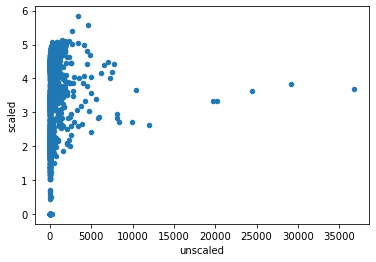

In [142]:
scaled_vs_unscaled_MTND4.plot.scatter(x = "unscaled", y = "scaled")

# PySpark

In [146]:
import pyspark
from pyspark.sql import SparkSession

In [ ]:
! sudo apt install -y openjdk-8-jdk-headless

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnuma1
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  ca-certificates-java java-common libavahi-client3 libavahi-common-data
  libavahi-common3 libcups2 libpcsclite1 libxi6 libxtst6
  openjdk-8-jre-headless
Suggested packages:
  default-jre cups-common pcscd openjdk-8-demo openjdk-8-source libnss-mdns
  fonts-dejavu-extra fonts-nanum fonts-ipafont-gothic fonts-ipafont-mincho
  fonts-wqy-microhei fonts-wqy-zenhei fonts-indic
The following NEW packages will be installed:
  ca-certificates-java java-common libavahi-client3 libavahi-common-data
  libavahi-common3 libcups2 libpcsclite1 libxi6 libxtst6
  openjdk-8-jdk-headless openjdk-8-jre-headless
0 upgraded, 11 newly installed, 0 to remove and 0 not upgraded.
Need to get 40.1 MB of archives.
After this operation, 145

In [147]:
spark = SparkSession.builder.master("local[*]").appName("SparkByExamples.com").getOrCreate()

JAVA_HOME is not set


RuntimeError: Java gateway process exited before sending its port number